In [1]:
import pandas as pd
import numpy as np
from IPython.display import HTML
import re
import glob
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

In [2]:
path = Path("Data-mining")

In [3]:
print(path)

Data-mining


In [4]:
path/"Data/Kenyanpaper2.csv"

PosixPath('Data-mining/Data/Kenyanpaper2.csv')

In [5]:
# grab all the CSV files of interest with a wildcard
csv_file_list = glob.glob("Data-mining/Data/Kenyapaper*.csv")

# show the result
print(csv_file_list)

[]


In [6]:
# make an empty list
dataframe_list = []

# loop through each filename, read in all the files and add it onto the empty list.
# this returns a list of dataframes
for filename in csv_file_list:
    data = pd.read_csv(filename, sep = "\t")
    dataframe_list.append(data)

# bring the list of dataframes to be one dataframe
#pd.concat(dataframe_list, sort=False)

In [7]:
#dataframe_list[1]

In [8]:
# load dataframe separated by spaces
authors = pd.read_csv("../Data/Kenyapapers.csv", sep = "\t")

# what are the column names
authors.columns

Index(['title', 'year', 'journal', 'lastname', 'firstname', 'address', 'email',
       'pmid', 'month', 'day'],
      dtype='object')

In [9]:
authors

,title,year,journal,lastname,firstname,address,email,pmid,month,day
0,Current Trends of Nanobiosensors for Point-of-...,2019.0,Journal of analytical methods in chemistry,Noah,Naumih M,"School of Pharmacy and Health Sciences, United...",NaN,31886019,1.0,1.0
1,Current Trends of Nanobiosensors for Point-of-...,2019.0,Journal of analytical methods in chemistry,Ndangili,Peter M,Department of Chemical Science and Technology ...,NaN,31886019,1.0,1.0
2,"Efficacy of Ivermectin, Liquid Paraffin, and C...",2019.0,Journal of tropical medicine,Ogolla,Kennedy O,"Department of Veterinary Pathology, Microbiolo...",NaN,31885634,1.0,1.0
3,"Efficacy of Ivermectin, Liquid Paraffin, and C...",2019.0,Journal of tropical medicine,Chebet,Joyce,"Department of Veterinary Pathology, Microbiolo...",NaN,31885634,1.0,1.0
4,"Efficacy of Ivermectin, Liquid Paraffin, and C...",2019.0,Journal of tropical medicine,Waruiru,Robert M,"Department of Veterinary Pathology, Microbiolo...",NaN,31885634,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...
74186,Distribution of biomass of species differing i...,1980.0,Oecologia,Boutton,Thomas W,"Department of Botany and Range Science, Brigha...",NaN,28309553,1.0,1.0
74187,Distribution of biomass of species differing i...,1980.0,Oecologia,Harrison,A Tyrone,"School of Life Sciences, University of Nebrask...",NaN,28309553,1.0,1.0
74188,Distribution of biomass of species differing i...,1980.0,Oecologia,Smith,Bruce N,"Department of Botany and Range Science, Brigha...",NaN,28309553,1.0,1.0
74189,The effects of wind and temperature on cuticul...,1980.0,Oecologia,Baig,M N,"Dept of Botany, University of Nairobi, P.O. Bo...",NaN,28309479,1.0,1.0


In [10]:
# convert each item in the column with lastname and firstname
def join_names(x): return str(x["lastname"]) + " " + str(x["firstname"])


# apply function to the dataset
authors["allauthors"] = authors.apply(join_names, axis = 1)

In [11]:
# join the author names together
def join_names(x): return str(x["lastname"]) + " " + str(x["firstname"]) + " " + str(x["address"])

# apply function to the dataset
authors["allauthorsinstitutions"] = authors.apply(join_names, axis = 1)

In [12]:
# set the index to be the title and pmid
author_indexes = authors.set_index(["title", "pmid"])

# take only the columns of interest
author_collab = author_indexes[["allauthors", "allauthorsinstitutions"]]

# see the first columns
#HTML(author_collab.to_html())

In [13]:
# convert dataframe into a html summary statistics report
profile = ProfileReport(author_collab)

# take the html and save it onto a file
#profile.to_file(output_file="output_author+institution.html") # renamed at the moment

In [14]:
# convert the profile object into ipywidgets object
profile.to_widgets() 

In [15]:
profile.to_notebook_iframe()

# Common authors 

Before trying to answers are the authors collaboration within or without. Let see who are most common authors:

Marsh kevin 

Snow Robert W

Bukusi Elizabeth A

English Mike

Berkley James A 

Cohen Craig R

Baeten Jared M

Scott J Anthony G

John-Stewart Grace

Breiman Robert F 

# Common authors + institutions
Gives us a clue which institutions are collaborating and common authors

Moloo S K International Laboratory for Research on Animal Diseases (ILRAD), Nairobi, Kenya 	 	
 
Plummer F A Department of Medical Microbiology, University of Nairobi, Kenya 		
 
Agot Kawango Impact Research and Development Organization, Kisumu, Kenya 	 	
 
Kyobutungi Catherine African Population and Health Research Center, Nairobi, Kenya 		
 
Ndinya-Achola J O Department of Medical Microbiology, University of Nairobi, Kenya 		
 
Grace Delia International Livestock Research Institute, Nairobi, Kenya 		
 
Kariuki Samuel Centre for Microbiology Research, Kenya Medical Research Institute, Nairobi, Kenya 		
 
Scott J Anthony G Kenya Medical Research Institute-Wellcome Trust Research Programme, Kilifi 		
 
Owiti P Academic Model Providing Access to Healthcare (AMPATH), Eldoret, Kenya 	

Morrison W I International Laboratory for Research on Animal Diseases, Nairobi, Kenya 

In [16]:
# subset the dataframe to see who are the collaborators of the most common institutions
# then see if the associated institutions are from outside in the address or inside 
# in code take the name of the user e.g Owiti P filter the all authors to have that name then look at the
# transposed data and look at the authors that collaborated with the person and the column address 

In [17]:
def show_collabs_prob (aut_name):
    '''
    Subsets a dataframe based on the name given and returns a Pandas Series with a probability of seeing that name, institution combination
    
    Args:
    aut_name this is the name of the author which is a string.
    '''
    find_collab = author_collab[author_collab.allauthors == aut_name]
    find_collab = find_collab["allauthorsinstitutions"].value_counts(normalize=True)
    return find_collab

show_collabs_prob("John-Stewart Grace")

John-Stewart Grace Department of Global Health, University of Washington, Seattle, WA, USA                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        0.049505
John-Stewart Grace Department of Global Health, University of Washington, Seattle, Washington, USA                                                                                                                                                                                                                                                                           

As for the common authors

The trend from the sample that looks into the most common author and institution is that the authors mostly do research and collaborate in departments within the organization/research institute. Fewer external collaborations from the table in Notebooks/Collaboration_trends.ipynb. In numbers about 29 institutions in Kenya and about 18 foreign. In addition, JKUAT has the least collaborations with the top institutions from this list except with KEMRI.

When looking at individual authors the trend is some authors are associated with certain institutions. Also, there are some who mostly collaborate outside additionally like in the previous group mostly internally within the organization/Institutes in different departments. On a side note, they have been only 3 publications related to Machine learning or complex statistical modeling within the time of study explicitly mentioned.

This is an experiment to look into interactions using graph theory. It needs more work.

## Drawing Plots

## Common authors

NB: Notice that the collaboration has been appended close to the name of the author

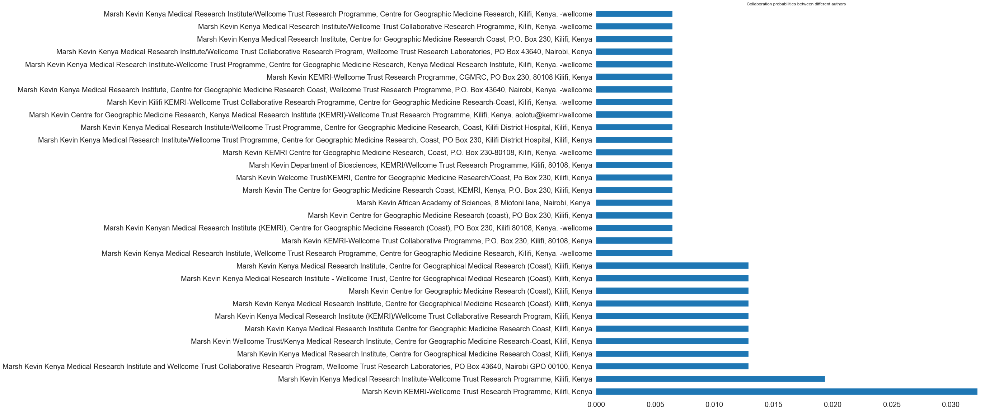

In [18]:
def show_collabs_prob (aut_name, figsize = (20,20), fontsize= 20):
    '''
    Subsets a dataframe based on the name given and returns a Pandas Series with a probability of seeing that name, institution combination
    It then plots it in a horizontal bar graph
    
    Args:
    aut_name this is the name of the author which is a string.
    '''
    find_collab = author_collab[author_collab.allauthors == aut_name]
    find_collab = find_collab["allauthorsinstitutions"].value_counts(normalize=True)[:31]
    return find_collab.plot(kind = "barh", title = "Collaboration probabilities between different authors", figsize = figsize, fontsize = fontsize)
    

show_collabs_prob("Marsh Kevin")

In [19]:
show_collabs_prob("Bukusi Elizabeth A", figsize=(80, 75), fontsize=90) 

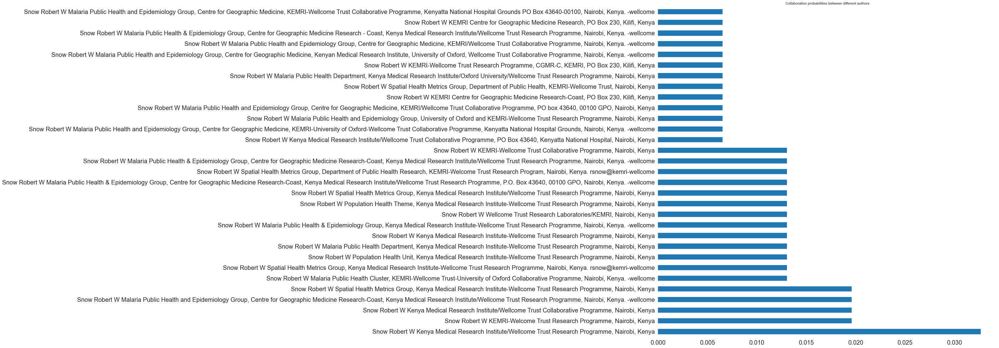

In [20]:
show_collabs_prob("Snow Robert W") 

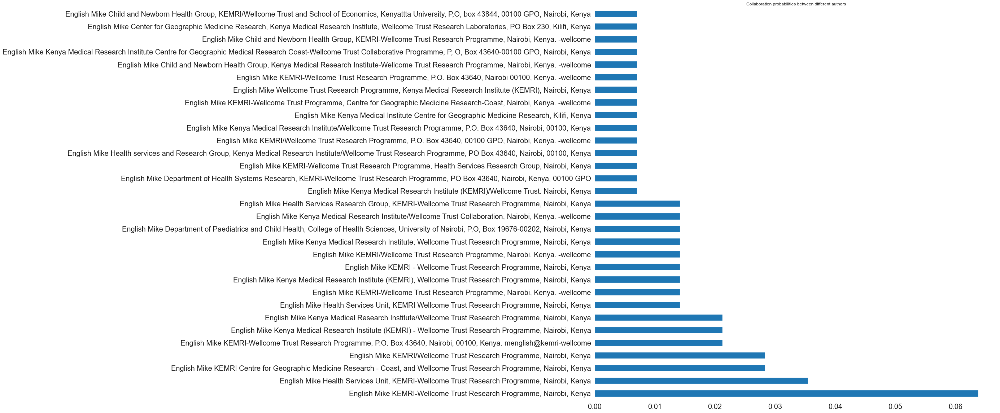

In [21]:
show_collabs_prob("English Mike") 

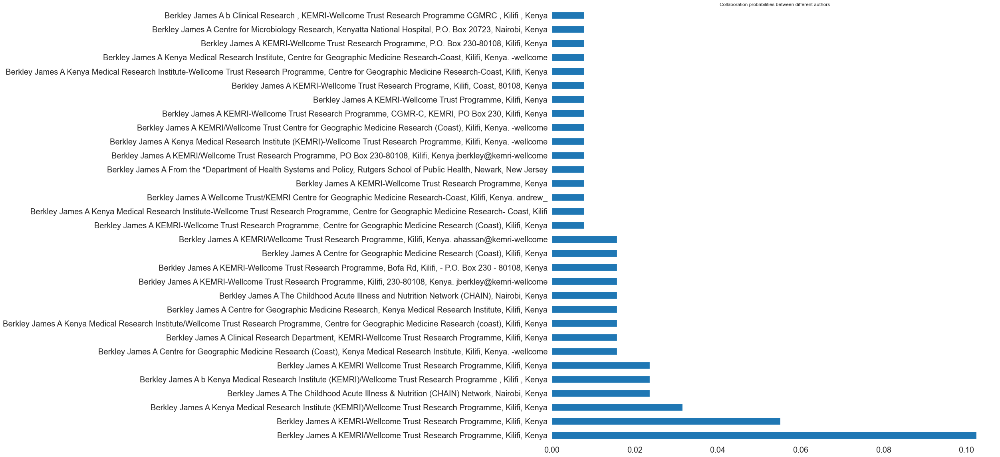

In [22]:
show_collabs_prob("Berkley James A")

In [23]:
show_collabs_prob("Cohen Craig R",figsize=(80, 75), fontsize=90)

In [24]:
show_collabs_prob("Baeten Jared M", figsize=(80, 75), fontsize=90)

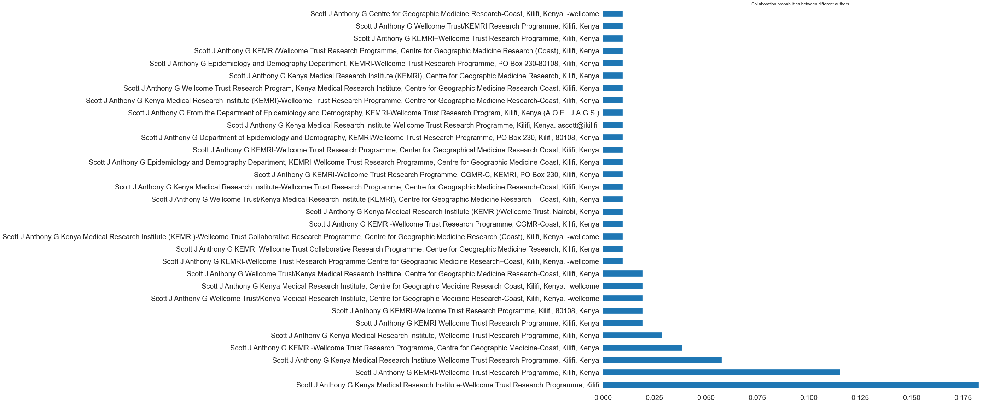

In [25]:
show_collabs_prob("Scott J Anthony G")

In [26]:
show_collabs_prob("John-Stewart Grace", figsize=(80, 75), fontsize=90)

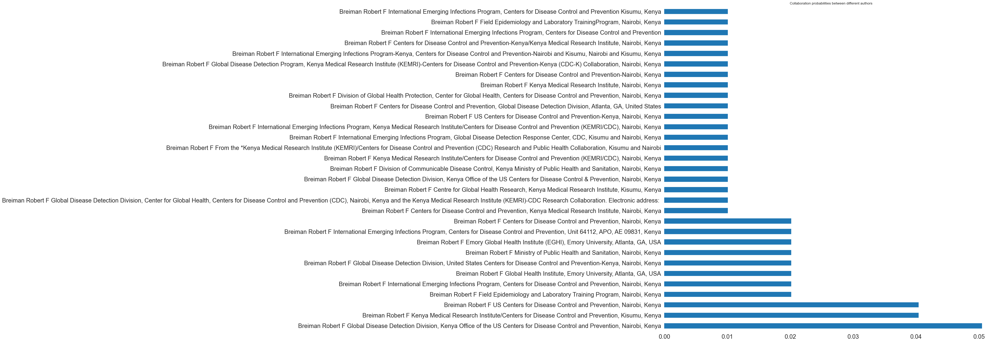

In [27]:
show_collabs_prob("Breiman Robert F")

# Common author + institutions

AxesSubplot(0.125,0.125;0.775x0.755)


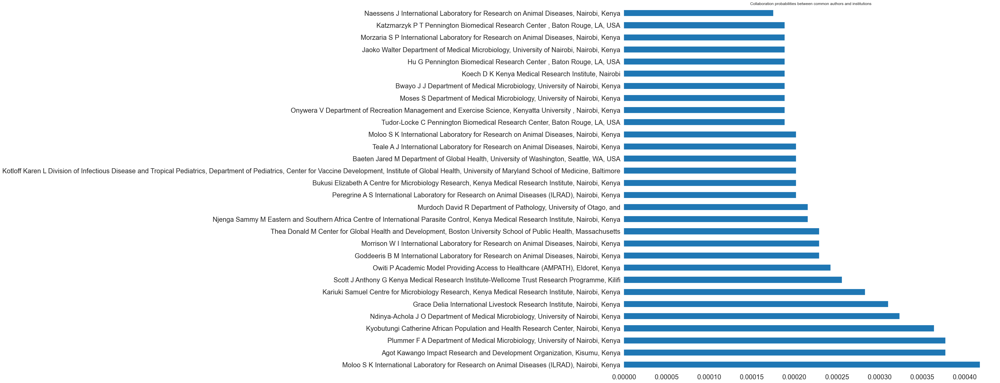

In [28]:
def show_collabs_prob2 (aut_name,sample_size, figsize = (20,20), fontsize = 20):
    '''
    Subsets a dataframe based on the name given and returns a Pandas Series with a probability of seeing that name, institution combination
    It then plots it in a horizontal bar graph
    
    Args:
    aut_name this is the name of the author which is a string.
    samp_size this is the number of rows to sample out of.
    '''
    find_collab = author_collab[author_collab.allauthorsinstitutions == aut_name]
    find_collab = author_collab["allauthorsinstitutions"].value_counts(normalize=True)[:sample_size]
    return find_collab.plot(kind = "barh", title = "Collaboration probabilities between common authors and institutions", figsize = figsize, fontsize = fontsize)


auth1 = show_collabs_prob2("Moloo S K International Laboratory for Research on Animal Diseases (ILRAD), Nairobi, Kenya", 30)
print(auth1)

AxesSubplot(0.125,0.125;0.775x0.755)


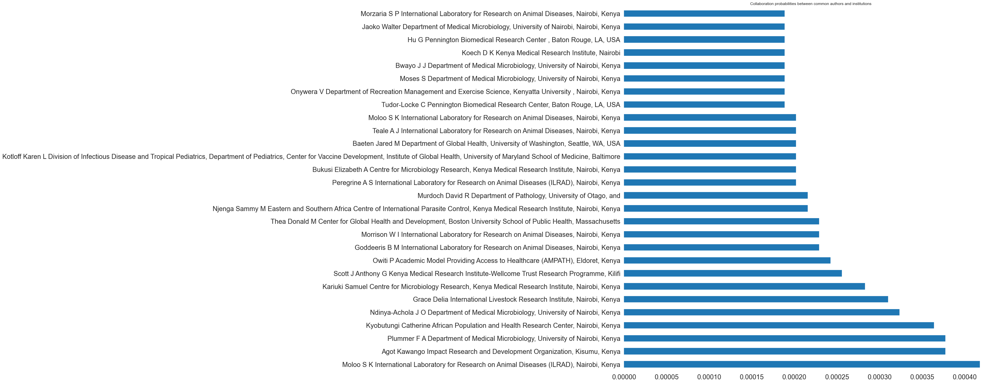

In [29]:
auth2 = show_collabs_prob2("Plummer F A Department of Medical Microbiology, University of Nairobi, Kenya", sample_size=28)
print(auth2)

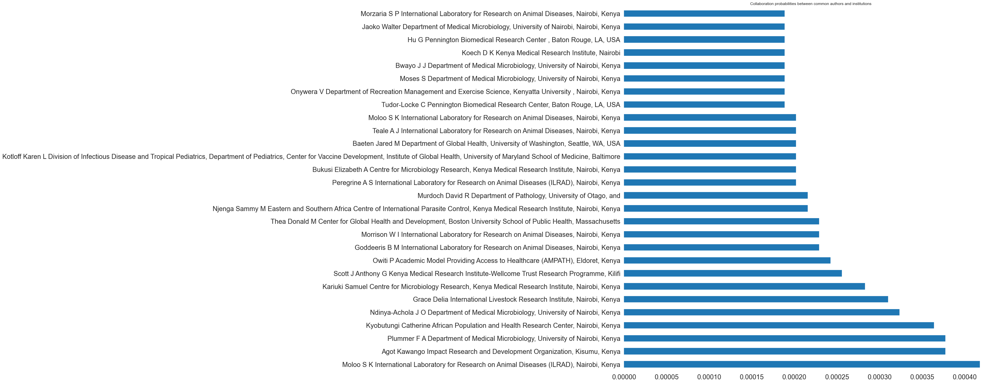

In [30]:
show_collabs_prob2("Agot Kawango Impact Research and Development Organization, Kisumu, Kenya", sample_size=28)

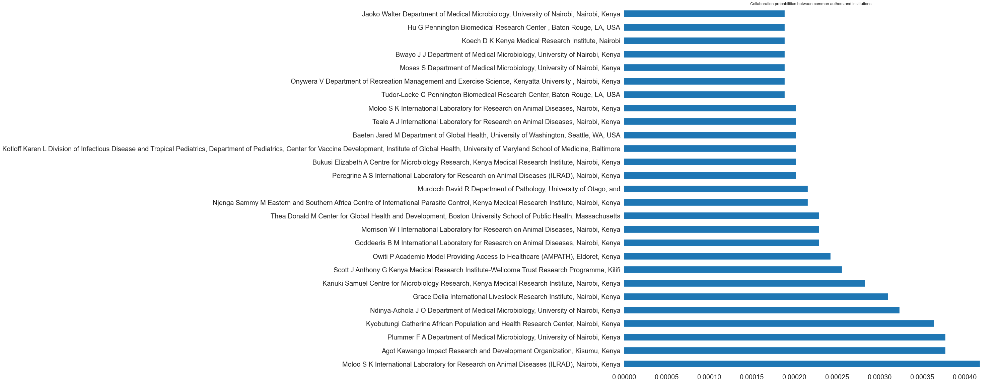

In [31]:
show_collabs_prob2("Kyobutungi Catherine African Population and Health Research Center, Nairobi, Kenya", sample_size=27)

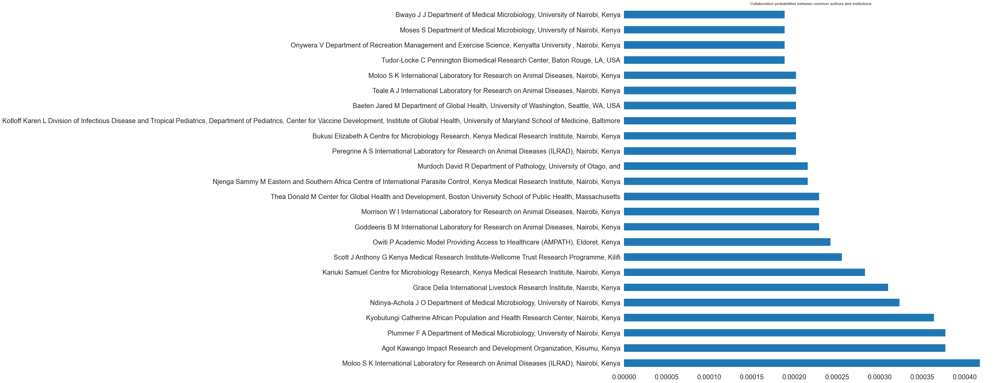

In [32]:
show_collabs_prob2("Ndinya-Achola J O Department of Medical Microbiology, University of Nairobi, Kenya",sample_size=24)

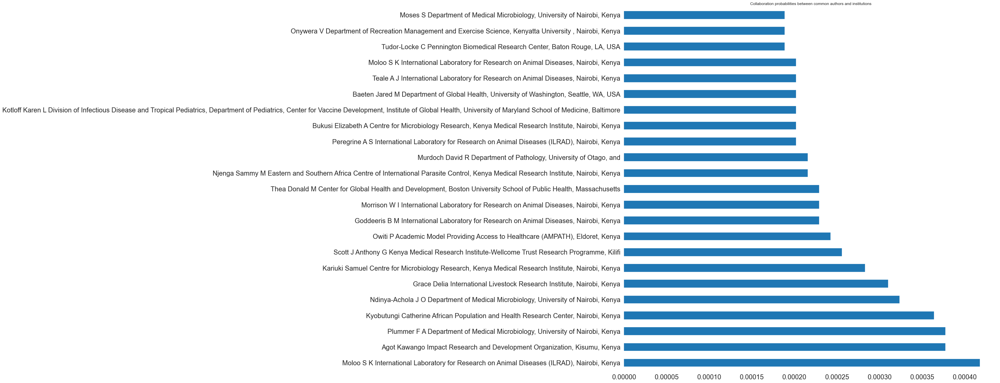

In [33]:
show_collabs_prob2("Grace Delia International Livestock Research Institute, Nairobi, Kenya", sample_size=23)

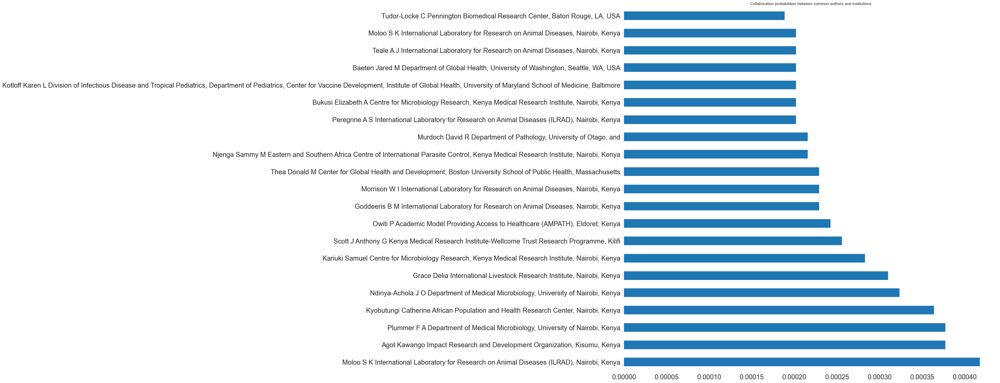

In [34]:
show_collabs_prob2("Kariuki Samuel Centre for Microbiology Research, Kenya Medical Research Institute, Nairobi, Kenya", sample_size=21)

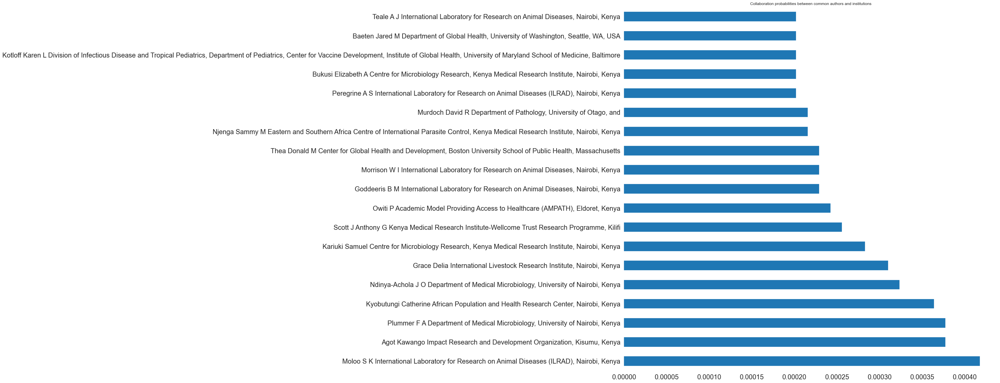

In [35]:
show_collabs_prob2("Scott J Anthony G Kenya Medical Research Institute-Wellcome Trust Research Programme, Kilifi", sample_size=19)

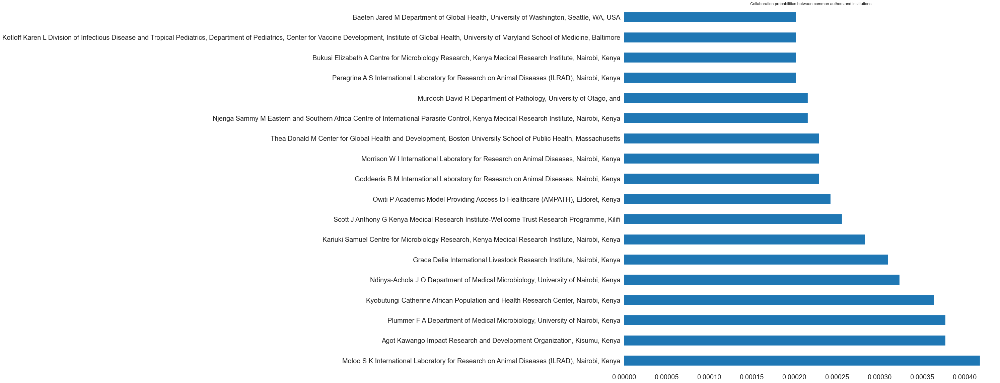

In [36]:
show_collabs_prob2("Owiti P Academic Model Providing Access to Healthcare (AMPATH), Eldoret, Kenya", sample_size=
                   18)

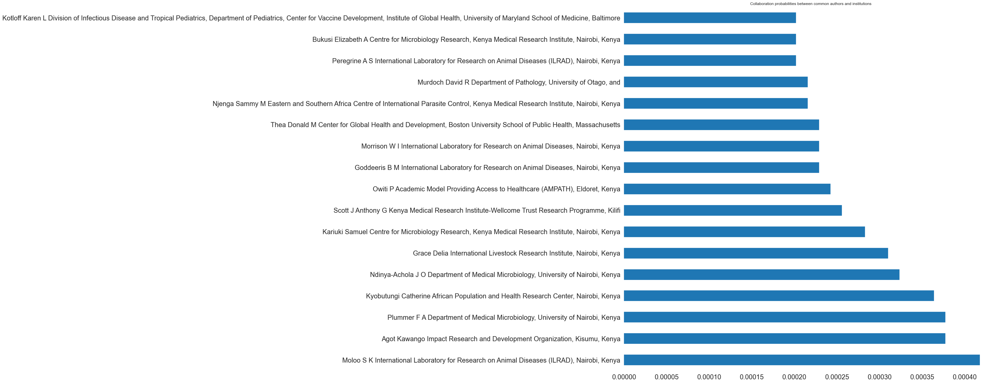

In [37]:
show_collabs_prob2("Morrison W I International Laboratory for Research on Animal Diseases, Nairobi, Kenya",sample_size=17)

# Drawing graphs 

Simply using graph (node + vertices) to reveal any trend in collaboration between the authors. Are they collaborating from within or without. The previous method we used was simply sampling but let's see if this will hold when looking at graphs. The first thing is to design the graph using pen and paper. We'll skip that step. Here, I chose to use the pmid which was unique per publication and also tied to the author or authors of the publication. In short, the pmid is associated with some title of a publication which is written by some authors. This can be represented as:

pmid -> author or authors 

author/authors -> pmid

In other words, several authors wrote a publication that was generated a specific pmid. 

In [38]:
# what variables are loaded

In [39]:
whos

Variable             Type             Data/Info
-----------------------------------------------
HTML                 type             <class 'IPython.core.display.HTML'>
Path                 type             <class 'pathlib.Path'>
ProfileReport        type             <class 'pandas_profiling.ProfileReport'>
auth1                AxesSubplot      AxesSubplot(0.125,0.125;0.775x0.755)
auth2                AxesSubplot      AxesSubplot(0.125,0.125;0.775x0.755)
author_collab        DataFrame                                 <...>n[74191 rows x 2 columns]
author_indexes       DataFrame                                 <...>[74191 rows x 10 columns]
authors              DataFrame                                 <...>[74191 rows x 12 columns]
csv_file_list        list             n=0
dataframe_list       list             n=0
glob                 module           <module 'glob' from '/Use<...>3/lib/python3.6/glob.py'>
join_names           function         <function join_names at 0x126e72510>
json 

In [40]:
from sklearn import preprocessing

# initialise the label Encoder object
le = preprocessing.LabelEncoder()

# fit and transform the names found the all authors column to a numbers
author_collab["num_label"] = le.fit_transform(author_collab.allauthors.values)

/Users/aoi-rain/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [41]:
# confirmation that it has worked
author_collab.head()

allauthors  \
title                                              pmid                         
Current Trends of Nanobiosensors for Point-of-C... 31886019     Noah Naumih M   
                                                   31886019  Ndangili Peter M   
Efficacy of Ivermectin, Liquid Paraffin, and Ca... 31885634  Ogolla Kennedy O   
                                                   31885634      Chebet Joyce   
                                                   31885634  Waruiru Robert M   

                                                                                        allauthorsinstitutions  \
title                                              pmid                                                          
Current Trends of Nanobiosensors for Point-of-C... 31886019  Noah Naumih M School of Pharmacy and Health Sc...   
                                                   31886019  Ndangili Peter M Department of Chemical Scienc...   
Efficacy of Ivermectin, Liquid Paraffin, and Ca... 31885634  Ogolla Kennedy O Department of Veterinary Path...   
                                                   31885634  Chebet Joyce Department of Veterinary Patholog...   
                                                   31885634  Waruiru Robert M Department of Veterinary Path...   

                                                             num_label  
title                                              pmid                 
Current Trends of Nanobiosensors for Point-of-C... 31886019      20756  
                                                   31886019      19521  
Efficacy of Ivermectin, Liquid Paraffin, and Ca... 31885634      22046  
                                                   31885634       3890  
                                                   31885634      30416

In [42]:
# remove the current index
all_author_collab = author_collab.reset_index()

# subset the pmid and num label columns from the dataframe
all_author_collab = all_author_collab[["pmid", "num_label"]]

In [43]:
# adjust the number of rows that can be shown
# look at documentation to fix this
pd.set_option('display.max_rows', 1000)

In [44]:
# see the dataframe object
# convert to a horizontal dataframe
all_author_collab.transpose()

,0,1,2,3,4,5,6,7,8,9,...,74181,74182,74183,74184,74185,74186,74187,74188,74189,74190
pmid,31886019,31886019,31885634,31885634,31885634,31885634,31885634,31885634,31885453,31883526,...,28309458,22065665,15615049,15615049,15615049,28309553,28309553,28309553,28309479,28309479
num_label,20756,19521,22046,3890,30416,6900,22469,134,14989,13717,...,18471,5171,24756,24486,25751,2953,8315,27542,1793,28985


In [45]:
# see if they are instances of repeats for each column
all_author_collab.pmid.value_counts(normalize=True)

25059949    0.001442
24797575    0.001173
31619795    0.001119
28384795    0.000997
25558364    0.000957
              ...   
28700682    0.000013
10079660    0.000013
24822161    0.000013
25194887    0.000013
26740833    0.000013
Name: pmid, Length: 15029, dtype: float64

In [46]:
# now looking at pmid
all_author_collab.pmid.value_counts()

25059949    107
24797575     87
31619795     83
28384795     74
25558364     71
           ... 
28700682      1
10079660      1
24822161      1
25194887      1
26740833      1
Name: pmid, Length: 15029, dtype: int64

In [47]:
author_collab.info(memory_usage=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 74191 entries, (Current Trends of Nanobiosensors for Point-of-Care Diagnostics., 31886019) to (The effects of wind and temperature on cuticular transpiration of Picea abies and Pinus cembra and their significance in dessication damage at the alpine treeline., 28309479)
Data columns (total 3 columns):
allauthors                74191 non-null object
allauthorsinstitutions    74191 non-null object
num_label                 74191 non-null int64
dtypes: int64(1), object(2)
memory usage: 2.2+ MB


In [48]:
# make a nodes dataframe
# consists of identifiers for nodes we have created
nodes_df_raw = author_collab.reset_index()
nodes_df = nodes_df_raw[["pmid", "allauthors", "num_label"]]

# export to csv
#nodes_df.to_csv("../data/nodes.csv", index=False)

In [49]:
nodes_df

,pmid,allauthors,num_label
0,31886019,Noah Naumih M,20756
1,31886019,Ndangili Peter M,19521
2,31885634,Ogolla Kennedy O,22046
3,31885634,Chebet Joyce,3890
4,31885634,Waruiru Robert M,30416
...,...,...,...
74186,28309553,Boutton Thomas W,2953
74187,28309553,Harrison A Tyrone,8315
74188,28309553,Smith Bruce N,27542
74189,28309479,Baig M N,1793


In [50]:
# add the name of institution the authors belong to 
all_author_collab["institution"] = authors["address"].values
all_author_collab

,pmid,num_label,institution
0,31886019,20756,"School of Pharmacy and Health Sciences, United..."
1,31886019,19521,Department of Chemical Science and Technology ...
2,31885634,22046,"Department of Veterinary Pathology, Microbiolo..."
3,31885634,3890,"Department of Veterinary Pathology, Microbiolo..."
4,31885634,30416,"Department of Veterinary Pathology, Microbiolo..."
...,...,...,...
74186,28309553,2953,"Department of Botany and Range Science, Brigha..."
74187,28309553,8315,"School of Life Sciences, University of Nebrask..."
74188,28309553,27542,"Department of Botany and Range Science, Brigha..."
74189,28309479,1793,"Dept of Botany, University of Nairobi, P.O. Bo..."


In [51]:
# make a relationship dataframe and store in csv
#all_author_collab.to_csv("../data/relationships.csv", index=False)

# Graph interpretation 

## Degree centrality

Degree centrality is the first metric we were able to calculate from the graph we generated in `scripts/spark_network_analysis.py`. Degree centrality looks at the number of connections. Here, the degree will be most important in particular the indegree(number of connections towards the node) because of how we designed the graph in the first place. It tells us how connected the nodes are and which individuals were popular within our network. 

In [52]:
# adjusting the view of rows and columns
pd.options.display.max_rows = 1000
pd.options.display.max_columns = 8

In [53]:
# import the data and do a join 
deg_cen = pd.read_csv("../data/degree_centrality.csv")

In [54]:
# use a inner intersection join between the id column and the num_label
all_deg_cen = deg_cen.merge(nodes_df, how = "inner", left_on="Id", right_on = "num_label")

# remove duplicate rows
all_deg_cen_prep = all_deg_cen.drop_duplicates("allauthors", keep = "first")

# subset the dataset to take the first 30 rows
all_deg_cen_prep[["pmid", "allauthors", "num_label","Degree"]][:31]

,pmid,allauthors,num_label,Degree
0,31681266,Marsh Kevin,15321,155
155,31504308,Snow Robert W,27602,153
308,31725431,Bukusi Elizabeth A,3313,143
451,31841540,English Mike,5876,141
592,31775877,Berkley James A,2403,127
719,31883526,Cohen Craig R,4407,114
833,31872948,Baeten Jared M,1769,106
939,31517041,Scott J Anthony G,26707,104
1043,31872948,John-Stewart Grace,9704,101
1144,31864916,Breiman Robert F,3059,99


If you take a couple of authors Kenyan authors you'll notice that they mostly collaborate with universities and institutions within the country with exceptions such as Bukusi Elizabeth and Kyobutungi Catherine being the outliers. Also, I have noticed some of the authors use abbreviations or shorten their names such as Marsh K and Bukusi Elizabeth A or Anne. Therefore, one should be careful not while looking at this data. This section reinforces my previous findings.

## page rank

page rank is used to assess who had the most influence in the network. Let's annotate that further by looking at the results. We need to adjust the parameters that were set in `script/spark_network_analysis.py` to get the right ones that work with this dataset.

In [55]:
!cat ../data/page_rank_score_maxIter100.csv

id,allauthors,num_label,page_rank
25631099,K'Oyugi Boniface O,9933,0.9999999999997176
26295263,Wamuyu Lucy,30040,0.9999999999997176
26295263,Obanda Vincent,21345,0.9999999999997176
26295263,Kariuki Daniel,10712,0.9999999999997176
26295263,Gakuya Francis,6726,0.9999999999997176
26295263,Makanda Moni,14860,0.9999999999997176
26295263,Otiende Moses,23663,0.9999999999997176
26295263,Ommeh Sheila,22802,0.9999999999997176
30784629,Otiso Lilian,23824,0.9999999999997176
30784629,Gitahi Githinji,7296,0.9999999999997176
26852449,Mangeni J N,15130,0.9999999999997176
26852449,Mwangi A,18849,0.9999999999997176
26852449,Mbugua S,15939,0.9999999999997176
26852449,Mukthar V K,17665,0.9999999999997176
31241426,Gitome Serah W,7432,0.9999999999997176
31241426,Kwena Zachary A,13090,0.9999999999997176
31241426,Harper Cynthia C,8294,0.9999999999997176
31241426,Cohen Craig R,4407,0.9999999999997176
31241426,Bukusi Elizabeth A,3313,0.9999999999997176
31839690,Vanlauwe Bernard,29323,0.9999999999997176
31839690

26785813,Shah Dilip M,26904,0.9999999999997176
26785813,Tripathi Leena,29011,0.9999999999997176
30197734,Ondieki George Kiage,23022,0.9999999999997176
30197734,Ombui Jackson Nyarongi,22761,0.9999999999997176
30197734,Obonyo Mark,21426,0.9999999999997176
30197734,Gura Zeinab,7974,0.9999999999997176
30197734,Githuku Jane,7417,0.9999999999997176
30197734,Orinde Austine Bitek,23479,0.9999999999997176
30197734,Gikunju Joseph Kangangi,7221,0.9999999999997176
11119512,Gicheru M M,7128,0.9999999999997176
11119512,Olobo J O,22586,0.9999999999997176
11119512,Anjili C O,1220,0.9999999999997176
11119512,Orago A S,23409,0.9999999999997176
11119512,Modabber F,16811,0.9999999999997176
11119512,Scott P,26717,0.9999999999997176
29858747,Mwando Nelson L,18830,0.9999999999997176
29858747,Tamiru Amanuel,28323,0.9999999999997176
29858747,Nyasani Johnson O,21150,0.9999999999997176
29858747,Obonyo Meshack A O,21429,0.9999999999997176
29858747,Subramanian Sevgan,28076,0.9999999999997176
26715029,Omosa Leonida

21531437,Dörfler Ulrike,5578,0.9999999999997176
21531437,Scherb Hagen,26560,0.9999999999997176
21531437,Getenga Zachary,7048,0.9999999999997176
21531437,Boga Hamadi,2779,0.9999999999997176
21531437,Schroll Reiner,26642,0.9999999999997176
12866795,Ochanda H,21483,0.9999999999997176
12866795,Young A S,31413,0.9999999999997176
12866795,Medley G F,16275,0.9999999999997176
29668861,Munywoki Patrick K,17978,0.9999999999997176
29668861,Koech Dorothy C,12455,0.9999999999997176
29668861,Agoti Charles N,521,0.9999999999997176
29668861,Cane Patricia A,3584,0.9999999999997176
29668861,Medley Graham F,16276,0.9999999999997176
29668861,Nokes D James,20766,0.9999999999997176
10472680,Perry B D,24594,0.9999999999997176
10472680,Kalpravidh W,10216,0.9999999999997176
10472680,Coleman P G,4450,0.9999999999997176
10472680,Horst H S,8871,0.9999999999997176
10472680,McDermott J J,16111,0.9999999999997176
10472680,Randolph T F,25282,0.9999999999997176
10472680,Gleeson L J,7490,0.9999999999997176
8645797,Tynd

30456133,Foggle John,6396,0.9999999999997176
30456133,Partridge Robert,24363,0.9999999999997176
30456133,Wang Yvonne,30125,0.9999999999997176
30456133,Kearney Alexis,11009,0.9999999999997176
30456133,Levine Adam C,13707,0.9999999999997176
30456133,Carter Jane,3664,0.9999999999997176
30456133,Tabu John S,28259,0.9999999999997176
20573278,Owino Eunice A,24010,0.9999999999997176
29031815,Achwoka Dunstan,283,0.9999999999997176
29031815,Pintye Jillian,24769,0.9999999999997176
29031815,McGrath Christine J,16153,0.9999999999997176
29031815,Kinuthia John,11909,0.9999999999997176
29031815,Unger Jennifer A,29198,0.9999999999997176
29031815,Obudho Norah,21441,0.9999999999997176
29031815,Langat Agnes,13341,0.9999999999997176
29031815,John-Stewart Grace,9704,0.9999999999997176
29031815,Drake Alison L,5414,0.9999999999997176
30240719,Wairimu Josephine,29733,0.9999999999997176
30240719,Ronoh Marilyn,25851,0.9999999999997176
30240719,Malonza David M,15040,0.9999999999997176
31417437,Ombati Elizabeth,2

23271468,Erdélyi Máté,5897,0.9999999999997176
23271468,Yenesew Abiy,31354,0.9999999999997176
29364184,Davis Emily,4925,0.9999999999997176
29364184,Aseyo Rose Evalyne,1414,0.9999999999997176
29364184,Muganda Damaris Nelima,17431,0.9999999999997176
29364184,Baker Kelly K,1833,0.9999999999997176
29364184,Mumma Jane,17812,0.9999999999997176
11921595,Ombui J N,22758,0.9999999999997176
11921595,Kagiko M M,10064,0.9999999999997176
11921595,Arimi S M,1331,0.9999999999997176
31160827,Willy Daniel Kyalo,30960,0.9999999999997176
31160827,Muyanga Milu,18686,0.9999999999997176
31160827,Mbuvi Joseph,16026,0.9999999999997176
31160827,Jayne Thomas,9584,0.9999999999997176
27109288,Dimba Eao,5254,0.9999999999997176
31045473,Wawire Jonathan,30535,0.9999999999997176
31045473,Sayed Shahin,26508,0.9999999999997176
31045473,Moloo Zahir,16944,0.9999999999997176
31045473,Sohani Aliyah R,27620,0.9999999999997176
26793272,Kariuki Symon M,10762,0.9999999999997176
26793272,Abubakar Amina,175,0.9999999999997176
267

23873752,Kiese Ralf,11478,0.9999999999997176
23873752,Neufeldt Henry,19852,0.9999999999997176
23873752,Butterbach-Bahl Klaus,3443,0.9999999999997176
26866110,Kioko P M,11990,0.9999999999997176
26866110,Olang P,22525,0.9999999999997176
26866110,Mwangi C,18861,0.9999999999997176
26866110,Chokwe T,4214,0.9999999999997176
31428173,Dida Gabriel O,5223,0.9999999999997176
28413897,Wawire Jonathan,30535,0.9999999999997176
28413897,Singh Kamaljeet,27388,0.9999999999997176
28413897,Steinhoff Margaret M,27899,0.9999999999997176
10492760,Berkley J,2400,0.9999999999997176
10492760,Mwarumba S,19041,0.9999999999997176
10492760,Bramham K,3008,0.9999999999997176
10492760,Lowe B,14106,0.9999999999997176
10492760,Marsh K,15320,0.9999999999997176
16619707,Koigi-Kamau R,12525,0.9999999999997176
16619707,Leting P K,13687,0.9999999999997176
16619707,Kiarie J N,11367,0.9999999999997176
25493942,Esamai Fabian,5921,0.9999999999997176
25493942,Liechty Edward,13809,0.9999999999997176
25493942,Ikemeri Justus,9180,

8833237,Teale A J,28459,0.9999999999997176
25912288,Kariuki Samuel,10755,0.9999999999997176
22581870,Ogendo A,21988,0.9999999999997176
22581870,Otieno F,23704,0.9999999999997176
22581870,Nyikuri M,21185,0.9999999999997176
22581870,Shinde S,27110,0.9999999999997176
22581870,Nyambura M,21027,0.9999999999997176
22581870,Pals S,24246,0.9999999999997176
22581870,Chege W,3929,0.9999999999997176
22581870,Gust D A,7981,0.9999999999997176
29584918,Feng Gaoqian,6210,0.9999999999997176
29584918,Boyle Michelle J,2975,0.9999999999997176
29584918,Cross Nadia,4697,0.9999999999997176
29584918,Chan Jo-Anne,3792,0.9999999999997176
29584918,Reiling Linda,25448,0.9999999999997176
29584918,Osier Faith,23560,0.9999999999997176
29584918,Stanisic Danielle I,27837,0.9999999999997176
29584918,Mueller Ivo,17368,0.9999999999997176
29584918,Anders Robin F,1129,0.9999999999997176
29584918,McCarthy James S,16065,0.9999999999997176
29584918,Richards Jack S,25554,0.9999999999997176
29584918,Beeson James G,2252,0.99999

30534187,Koigi Reuben Kamau,12524,0.9999999999997176
30534187,Obondo Anne,21411,0.9999999999997176
30534187,Ogoyi Dorington,22069,0.9999999999997176
30534187,Kogi-Makau Wambui,12508,0.9999999999997176
8268493,Moloo S K,16942,0.9999999999997176
25296095,McKinnon Lyle R,16183,0.9999999999997176
25296095,Nyanga Billy,21097,0.9999999999997176
25296095,Kim Connie J,11622,0.9999999999997176
25296095,Izulla Preston,9424,0.9999999999997176
25296095,Kwatampora Jessie,13078,0.9999999999997176
25296095,Kimani Makobu,11711,0.9999999999997176
25296095,Shahabi Kamnoosh,26930,0.9999999999997176
25296095,Mugo Nelly,17465,0.9999999999997176
25296095,Smith Jennifer S,27559,0.9999999999997176
25296095,Anzala A Omu,1265,0.9999999999997176
25296095,Kimani Joshua,11705,0.9999999999997176
25296095,Kaul Rupert,10941,0.9999999999997176
8033772,Oliech J S,22557,0.9999999999997176
8033772,Awori N,1612,0.9999999999997176
8033772,Otieno L S,23753,0.9999999999997176
8033772,Abdullah M S,84,0.9999999999997176
307645

21132491,Adoli Florence K L,407,0.9999999999997176
21132491,Lalah Joseph O,13250,0.9999999999997176
21132491,Okoth Alexander O,22386,0.9999999999997176
24088687,Grossman Daniel,7864,0.9999999999997176
24088687,Onono Maricianah,23162,0.9999999999997176
24088687,Newmann Sara J,19891,0.9999999999997176
24088687,Blat Cinthia,2703,0.9999999999997176
24088687,Bukusi Elizabeth A,3313,0.9999999999997176
24088687,Shade Starley B,26887,0.9999999999997176
24088687,Steinfeld Rachel L,27896,0.9999999999997176
24088687,Cohen Craig R,4407,0.9999999999997176
11991032,Morino Gianfranco,17086,0.9999999999997176
11991032,Giaccardi G C,7086,0.9999999999997176
11991032,Brundisini R,3241,0.9999999999997176
11991032,Ansaloni L,1233,0.9999999999997176
11991032,Giaccardi S,7087,0.9999999999997176
27232997,Muthengi Eunice,18426,0.9999999999997176
27232997,Gitau Tabither,7334,0.9999999999997176
27232997,Austrian Karen,1567,0.9999999999997176
25627802,Zhou Guofa,31589,0.9999999999997176
25627802,Afrane Yaw A,447,

27586821,Mukungu Nillian,17672,0.9999999999997176
27586821,Abuga Kennedy,187,0.9999999999997176
27586821,Okalebo Faith,22219,0.9999999999997176
27586821,Ingwela Raphael,9255,0.9999999999997176
27586821,Mwangi Julius,18914,0.9999999999997176
16164011,Githiori John B,7396,0.9999999999997176
16164011,Höglund Johan,9114,0.9999999999997176
16164011,Waller Peter J,29865,0.9999999999997176
29611500,Jaron Peter,9565,0.9999999999997176
29611500,Moke Fenny,16919,0.9999999999997176
29611500,Juma Jane,9881,0.9999999999997176
29611500,Ochieng John B,21528,0.9999999999997176
29611500,Omore Richard,22916,0.9999999999997176
29611500,Montgomery Joel M,16999,0.9999999999997176
24778879,Ogeng'o Julius,21999,0.9999999999997176
24778879,Ongeti Kevin,23114,0.9999999999997176
24778879,Obimbo Moses,21399,0.9999999999997176
24778879,Olabu Beda,22503,0.9999999999997176
24778879,Mwachaka Philip,18712,0.9999999999997176
30486867,Otiso Lilian,23824,0.9999999999997176
30486867,Muturi Nelly,18665,0.9999999999997176


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This algorithm needs to be tuned. However, we seeing the first authors who presumably come from Kenya at least the first authors. This could just be an artifact from the query we did with the easypubmed package. Someone should run different iterations and adjust the resetProbability  of the algorithm. 

## label propagation

Label propagation was mostly used to find any inherent groupings that are present in the graph. Though I'd suggest looking at strongly connected components to get better picture.

In [56]:
!cat ../data/labelPropagation.txt

+-----+--------------------------------------------------------------------------------------------------------------------------------------------+
|label|pmid                                                                                                                           |
+-----+--------------------------------------------------------------------------------------------------------------------------------------------+
|0    |[10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801]                                                  |
|1    |[10715684]                                                                                                                                  |
|2    |[12199442, 12199442]                                                                                                                        |
|3    |[12389953, 12389953, 12389953, 12389953]                                                                        

## Strongly connected components

This metric is used to find connected clusters in the graph. 

In [57]:
!cat ../data/StronglyconnectedComponents.txt

+---------+--------------------------------------------------------------------------------------------------------------------------------------------+
|component|pmid                                                                                                                                        |
+---------+--------------------------------------------------------------------------------------------------------------------------------------------+
|0        |[10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801]                                                  |
|1        |[10715684]                                                                                                                                  |
|2        |[12199442, 12199442]                                                                                                                        |
|3        |[12389953, 12389953, 12389953, 12389953]                               

The strongly connected components and the label propagation algorithms revealed authors working on a publication. The authors were from the same university or institution especially looking at those with more than two authors from the sample. This continues to approve or previous hypothesis about that authors are mostly collaborating from within with some instances of without from few authors.

# Conclusion

Common authors and institutions

We can see that most of the authors here are collaborating with each other while doing research especially Moloo SK from ILRAD who has collaborated with all individuals present in the sample. Furthermore, Bukusi Elizabeth is also collaborating with the sample of authors found too.

Common authors

When looking at individual authors the trend from the sample of 30 for each some authors are associated with certain institutions. Also, there are some who mostly collaborate outside for example Bukusi Elizabeth. Whereas the other authors it seems to be internally within the organization or Institutes in different departments; this is within the country. On a side note, they have been only 3 publications related to Machine learning within the time of study explicitly mentioned therefore this could be an area to look into as well for the reader. 

Network analysis

As for the network analysis label propagation and or strongly connected components clearly revealed the groups present in the dataset especially with publications greater than 3 were mostly from the same institution from our sample size and the degree centrality also shone a light on our most popular collaborators such as Marsh K (Kenya Medical Research Institute[KEMRI] Wellcome Trust), Cohen Craig R (UCSF), Baeten Jared M (University of Washington) ,Bukusi Elizabeth A(Kenya Medical Research Institute) and Kyobutungi Catherine (Africa Population Health Research Center) to mention afew.